<a href="https://colab.research.google.com/github/garvit26/F1-Telemetry-Advanced-Race-Analytics/blob/main/F1_Telemetry_%26_Advanced_Race_Analytics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install fastf1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 123.0/123.0 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.0/138.0 kB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.4/61.4 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 48.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.3/68.3 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.7/70.7 kB 5.4 MB/s eta 0:00:00
  Created wheel for msgpack: filename=msgpack-1.0.2-cp312-cp312-linux_x86_64.whl size=15820 sha256=22ab87afcc0d8648d35d2081abd5a87364c2230136522011fefa1c979ca4ccbb
  Stored in directory: /root/.cache/pip/wheels/67/a6/40/eda0983e595bbf3841af96dbff2340be72dfac96796fc3d578
Successfully built msgpack
  Attempting uninstall: msgpack
    Found existing installation: msgpack 1.1.2
    Uninstalling msgpack-1.1.2:
      Successfully uninstalled msgpack-1.1.2
  Attempting uninstall: websocke

In [2]:
from matplotlib import pyplot as plt

import fastf1
from fastf1 import plotting


# Enable Matplotlib patches for plotting timedelta values and load
# FastF1's dark color scheme
fastf1.plotting.setup_mpl(mpl_timedelta_support=True, color_scheme='fastf1')

core           INFO 	Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
INFO:fastf1.fastf1.core:Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
req            INFO 	No cached data found for session_info. Loading data...
INFO:fastf1.fastf1.req:No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
INFO:fastf1.api:Fetching session info data...
req            INFO 	Data has been written to cache!
INFO:fastf1.fastf1.req:Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
INFO:fastf1.fastf1.req:No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
INFO:fastf1.api:Fetching driver list...
req            INFO 	Data has been written to cache!
INFO:fastf1.fastf1.req:Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
INFO:fastf1.fastf1.req:No cached data found for sess

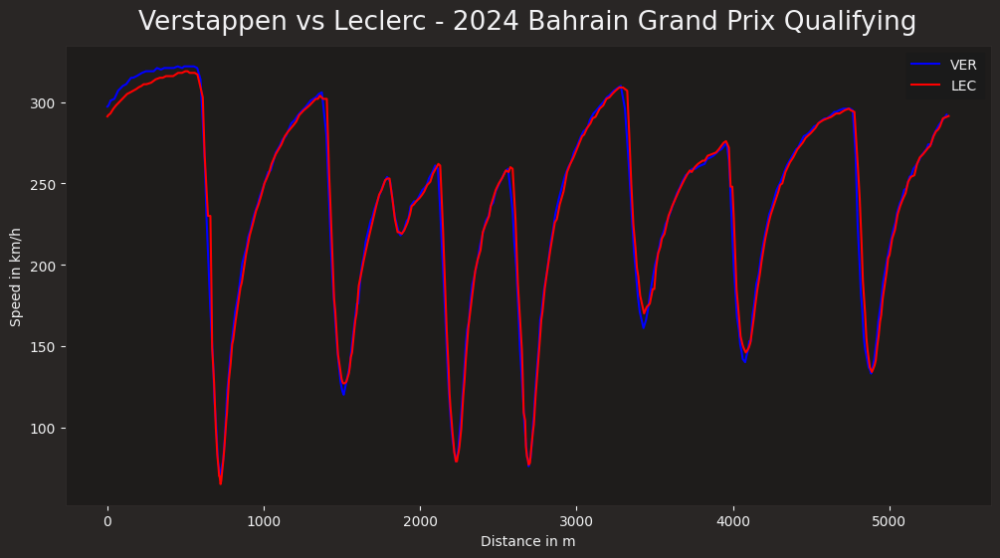

In [7]:
# 1. Load the session (2024 Bahrain GP, Qualifying)
race = fastf1.get_session(2024, 'Bahrain', 'Q')
race.load()

# 2. Pick the fastest laps for two drivers
ver_lap = race.laps.pick_driver('VER').pick_fastest()
lec_lap = race.laps.pick_driver('LEC').pick_fastest()

# 3. Get the telemetry data (Speed, RPM, Gear, etc.)
ver_tel = ver_lap.get_telemetry().add_distance()
lec_tel = lec_lap.get_telemetry().add_distance()

# 4. Plot Speed vs. Distance
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(ver_tel['Distance'], ver_tel['Speed'], color='blue', label='VER')
ax.plot(lec_tel['Distance'], lec_tel['Speed'], color='red', label='LEC')

ax.set_xlabel('Distance in m')
ax.set_ylabel('Speed in km/h')
ax.legend()
plt.title(f"Verstappen vs Leclerc - {race.event.year} {race.event.EventName} Qualifying")
plt.show()

core           INFO 	Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
INFO:fastf1.fastf1.core:Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
req            INFO 	Using cached data for session_info
INFO:fastf1.fastf1.req:Using cached data for session_info
req            INFO 	Using cached data for driver_info
INFO:fastf1.fastf1.req:Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
INFO:fastf1.fastf1.req:Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
INFO:fastf1.fastf1.req:Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
INFO:fastf1.fastf1.req:Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
INFO:fastf1.fastf1.req:Using cached data for timing_app_data
core           INFO 	Processing timing data...
INFO:fastf1.fastf1.core:Processing timing data...
req         

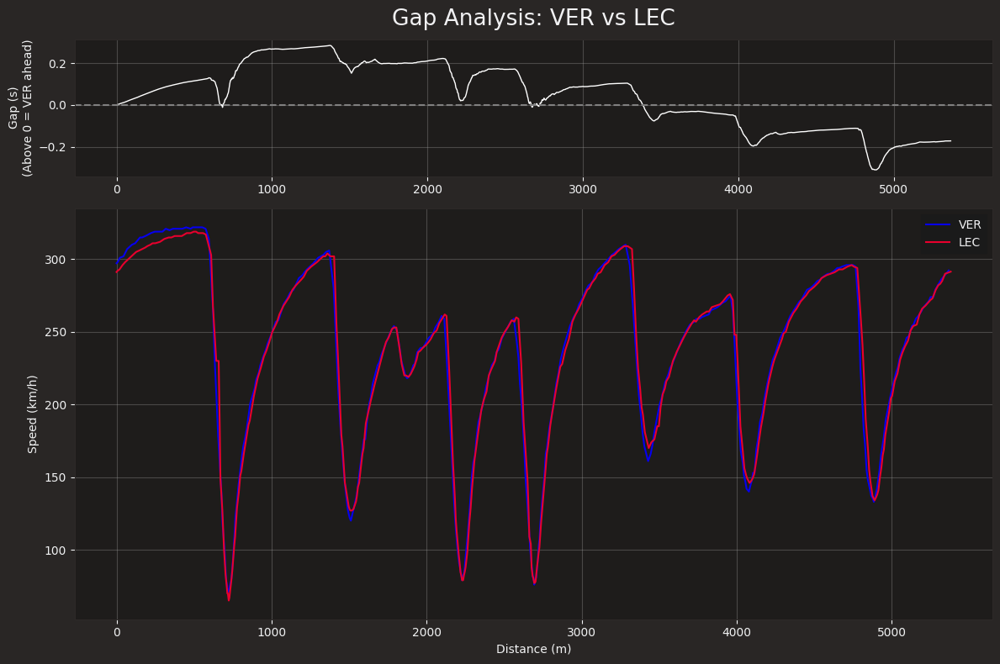

In [12]:

import matplotlib.pyplot as plt
import numpy as np

# 1. Setup
fastf1.plotting.setup_mpl()
# Ensure you have a cache enabled (uncomment if needed)
# fastf1.Cache.enable_cache('examples_cache')

# 2. Load the Session (Qualifying is best for pure speed comparison)
race = fastf1.get_session(2024, 'Bahrain', 'Q')
race.load()

# 3. Select two drivers to compare
driver1 = 'VER'
driver2 = 'LEC'

# 4. Get their fastest laps and telemetry
laps_d1 = race.laps.pick_driver(driver1).pick_fastest()
laps_d2 = race.laps.pick_driver(driver2).pick_fastest()

# Get telemetry and ADD DISTANCE (crucial!)
tel_d1 = laps_d1.get_telemetry().add_distance()
tel_d2 = laps_d2.get_telemetry().add_distance()

# 5. The Math: Interpolation
# We create a "common road" of 4000 points (or track length) to map both drivers onto
# We use the driver with the SHORTER distance to avoid extrapolating off the track
track_length = min(tel_d1['Distance'].max(), tel_d2['Distance'].max())
common_dist = np.linspace(0, track_length, num=4000)

# Interpolate Time vs Distance
# We want to know: "At 500m, what was the timestamp for VER? What was it for LEC?"
time_d1 = np.interp(common_dist, tel_d1['Distance'], tel_d1['Time'].dt.total_seconds())
time_d2 = np.interp(common_dist, tel_d2['Distance'], tel_d2['Time'].dt.total_seconds())

# Calculate the Delta (Difference)
delta_time = time_d2 - time_d1  # Positive means D1 is faster (D2 is behind)

# 6. Plotting
fig, ax = plt.subplots(2, 1, figsize=(12, 8), gridspec_kw={'height_ratios': [1, 3]})

# Top Plot: The Delta
ax[0].plot(common_dist, delta_time, color='white', linewidth=1)
ax[0].axhline(0, color='gray', linestyle='--')
ax[0].set_ylabel(f"Gap (s)\n(Above 0 = {driver1} ahead)")
ax[0].set_title(f"Gap Analysis: {driver1} vs {driver2}")
ax[0].grid(True, alpha=0.3)

# Bottom Plot: Speed Trace
# FIX: Use get_driver_color with the session argument
d1_color = fastf1.plotting.get_driver_color(driver1, session=race)
d2_color = fastf1.plotting.get_driver_color(driver2, session=race)

ax[1].plot(tel_d1['Distance'], tel_d1['Speed'], color=d1_color, label=driver1)
ax[1].plot(tel_d2['Distance'], tel_d2['Speed'], color=d2_color, label=driver2)

ax[1].set_xlabel('Distance (m)')
ax[1].set_ylabel('Speed (km/h)')
ax[1].legend()
ax[1].grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"


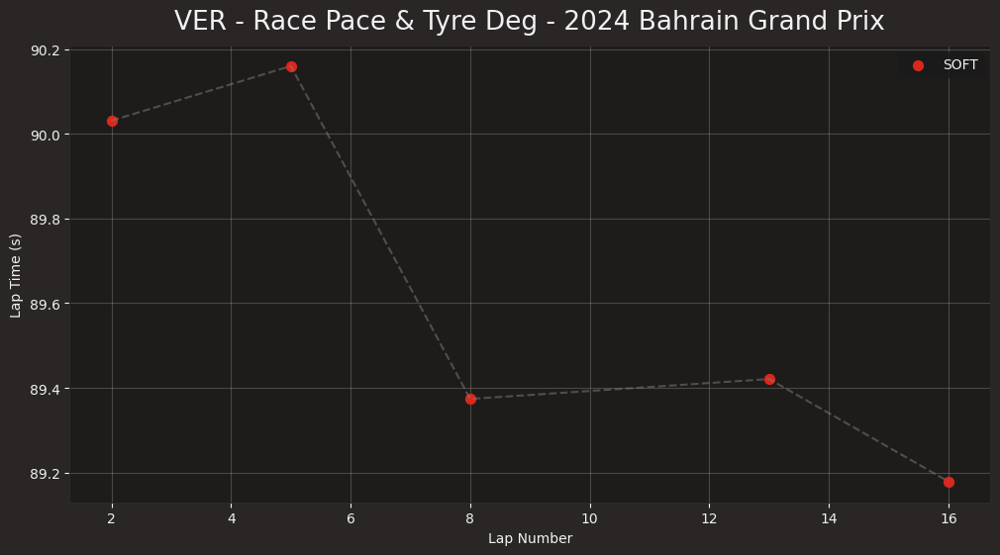

In [13]:


# 3. Pick a Driver
driver = 'VER'
laps = race.laps.pick_driver(driver)

# 4. Filter Data
# We only want "racing" laps. Remove:
# - Pit In/Out laps (they are slow)
# - Safety Car laps (optional, but good for cleanliness)
laps = laps.pick_quicklaps()  # Removes obviously slow laps/yellow flags
laps = laps.reset_index()      # Reset index to make plotting easier

# 5. Prepare Plotting
fig, ax = plt.subplots(figsize=(12, 6))

# Define compound colors (FastF1 standard colors)
compound_colors = {
    'SOFT': '#da291c',
    'MEDIUM': '#ffd12e',
    'HARD': '#f0f0f0',
    'INTERMEDIATE': '#43d62c',
    'WET': '#2c69d6'
}

# 6. Plotting
# We iterate through the laps to color them by compound
for compound in laps['Compound'].unique():
    subset = laps[laps['Compound'] == compound]
    ax.scatter(subset['LapNumber'], subset['LapTime'].dt.total_seconds(),
               label=compound,
               color=compound_colors.get(compound, 'white'),
               s=50) # s is size of dots

# Add a line connecting the dots to see the trend easier
ax.plot(laps['LapNumber'], laps['LapTime'].dt.total_seconds(), color='grey', alpha=0.5, linestyle='--')

# 7. Formatting
ax.set_xlabel('Lap Number')
ax.set_ylabel('Lap Time (s)')
ax.set_title(f"{driver} - Race Pace & Tyre Deg - {race.event.year} {race.event.EventName}")
ax.legend()
ax.grid(True, alpha=0.3)
ax.invert_yaxis() # In racing, LOWER time is HIGHER on the chart (usually)
# However, for deg analysis, usually we keep higher time = higher up to show the "slope" of getting slower.
# Let's keep normal axis (Higher Y = Slower) to visualize degradation "climbing" up.
ax.invert_yaxis() # actually, let's UNDO this. If I invert, slower laps go down.
# Standard analytics practice: Slower laps (higher time) go UP.
# So I will REMOVE the invert_yaxis() line.

plt.show()

/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"
/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"


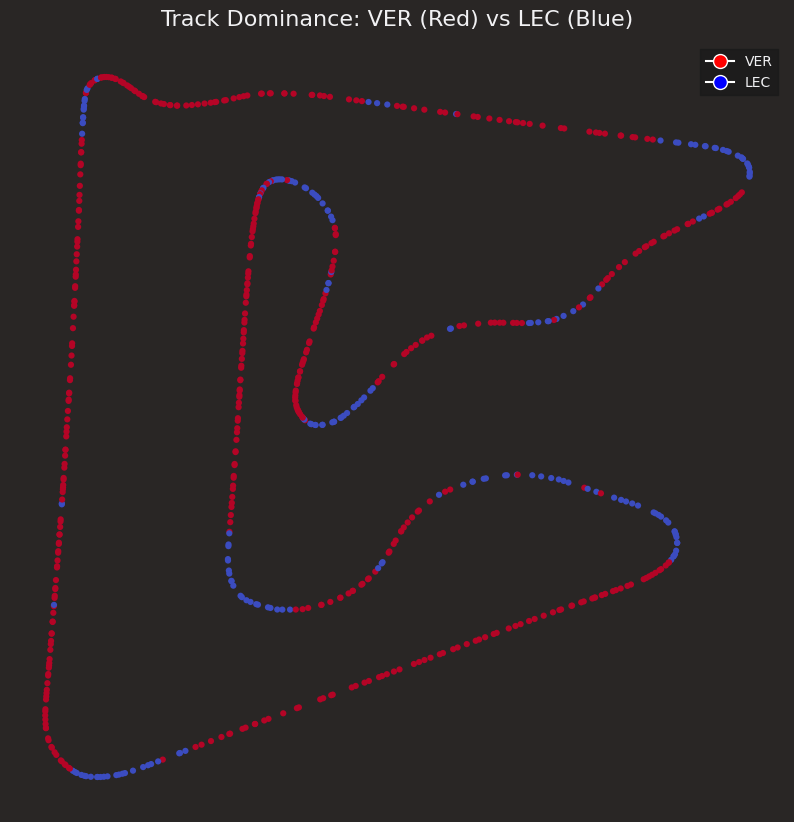

In [15]:


# 2. Select Drivers
driver1 = 'VER'
driver2 = 'LEC'

# 3. Get Telemetry for Fastest Laps
laps_d1 = race.laps.pick_driver(driver1).pick_fastest()
laps_d2 = race.laps.pick_driver(driver2).pick_fastest()

# Get telemetry including X, Y coordinates (crucial for mapping)
tel_d1 = laps_d1.get_telemetry().add_distance()
tel_d2 = laps_d2.get_telemetry().add_distance()

# 4. Merge Data for Comparison
# We merge on 'Distance' to compare speeds at the same track position
# Rounding distance to nearest meter helps align the data
tel_d1['Distance'] = tel_d1['Distance'].round(0)
tel_d2['Distance'] = tel_d2['Distance'].round(0)

# Merge the two dataframes
merged = pd.merge_asof(tel_d1, tel_d2, on='Distance', suffixes=(f'_{driver1}', f'_{driver2}'))

# 5. Calculate "Who is Faster?"
# Create a boolean column: True if Driver 1 is faster
merged['d1_faster'] = merged[f'Speed_{driver1}'] > merged[f'Speed_{driver2}']

# 6. Plotting the Map
fig, ax = plt.subplots(figsize=(10, 10))

# We scatter plot the X, Y coordinates
# We color points based on who is faster
# cmap selection: 'coolwarm' gives us Red vs Blue distinct colors
# c argument takes our boolean (0 or 1) and maps it to the colors
scatter = ax.scatter(merged['X_VER'], merged['Y_VER'],
                     c=merged['d1_faster'],
                     cmap='coolwarm',
                     s=20,     # Size of dots
                     linewidths=0)

# 7. Make it pretty
ax.set_title(f"Track Dominance: {driver1} (Red) vs {driver2} (Blue)", fontsize=16)
ax.axis('off') # Remove the box/grid for a cleaner map look

# Add a custom legend manually (since scatter colormaps are tricky to legend)
from matplotlib.lines import Line2D
legend_elements = [Line2D([0], [0], marker='o', color='w', markerfacecolor='red', label=driver1, markersize=10),
                   Line2D([0], [0], marker='o', color='w', markerfacecolor='blue', label=driver2, markersize=10)]
ax.legend(handles=legend_elements, loc='upper right')

plt.show()

In [17]:
import pandas as pd

session = fastf1.get_session(2024, 'Bahrain', 'Q')
session.load()

# 3. Get Telemetry for Fastest Laps
laps_d1 = session.laps.pick_drivers(driver1).pick_fastest()
laps_d2 = session.laps.pick_drivers(driver2).pick_fastest()

# Add distance to telemetry (Crucial for mapping corners)
tel_d1 = laps_d1.get_telemetry().add_distance()
tel_d2 = laps_d2.get_telemetry().add_distance()

# 4. Get Circuit Information
# This provides the official distance markers for every corner
circuit_info = session.get_circuit_info()

# 5. Analyze Every Corner
corner_data = []

# Iterate through each corner listed in the circuit info
for index, row in circuit_info.corners.iterrows():
    corner_number = row['Number']
    corner_dist = row['Distance']

    # Define a window (buffer) around the corner marker
    # 50m before and 50m after usually captures the apex
    buffer = 50
    start_dist = corner_dist - buffer
    end_dist = corner_dist + buffer

    # Filter telemetry to just this corner
    d1_corner = tel_d1[(tel_d1['Distance'] >= start_dist) & (tel_d1['Distance'] <= end_dist)]
    d2_corner = tel_d2[(tel_d2['Distance'] >= start_dist) & (tel_d2['Distance'] <= end_dist)]

    # Calculate Apex Speed (Minimum Speed in that sector)
    if not d1_corner.empty and not d2_corner.empty:
        speed_d1 = d1_corner['Speed'].min()
        speed_d2 = d2_corner['Speed'].min()

        delta = speed_d1 - speed_d2 # Positive = Driver 1 is faster

        corner_data.append({
            'Corner': corner_number,
            f'{driver1} (km/h)': speed_d1,
            f'{driver2} (km/h)': speed_d2,
            'Delta': round(delta, 2),
            'Advantage': driver1 if delta > 0 else driver2
        })

# 6. Create and Display Table
df_corners = pd.DataFrame(corner_data)

# Print a clean text table
print(f"Apex Speed Comparison: {driver1} vs {driver2} (Bahrain 2024 Q)")
print("=" * 60)
# formatting the float columns to look cleaner
print(df_corners.to_string(index=False, float_format="%.1f"))

core           INFO 	Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
INFO:fastf1.fastf1.core:Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
req            INFO 	Using cached data for session_info
INFO:fastf1.fastf1.req:Using cached data for session_info
req            INFO 	Using cached data for driver_info
INFO:fastf1.fastf1.req:Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
INFO:fastf1.fastf1.req:Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
INFO:fastf1.fastf1.req:Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
INFO:fastf1.fastf1.req:Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
INFO:fastf1.fastf1.req:Using cached data for timing_app_data
core           INFO 	Processing timing data...
INFO:fastf1.fastf1.core:Processing timing data...
req         

Apex Speed Comparison: VER vs LEC (Bahrain 2024 Q)
 Corner  VER (km/h)  LEC (km/h)  Delta Advantage
      1        71.0        65.0    6.0       VER
      2       108.4       104.0    4.3       VER
      3       204.3       202.1    2.2       VER
      4       120.0       127.0   -7.0       LEC
      5       241.0       240.7    0.3       VER
      6       218.0       219.0   -1.0       LEC
      7       227.0       224.2    2.8       VER
      8        79.0        79.0    0.0       LEC
      9       148.0       159.2  -11.2       LEC
     10        76.0        77.0   -1.0       LEC
     11       161.0       170.0   -9.0       LEC
     12       262.0       264.0   -2.0       LEC
     13       140.0       146.0   -6.0       LEC
     14       133.0       134.0   -1.0       LEC
     15       151.9       150.0    1.9       VER


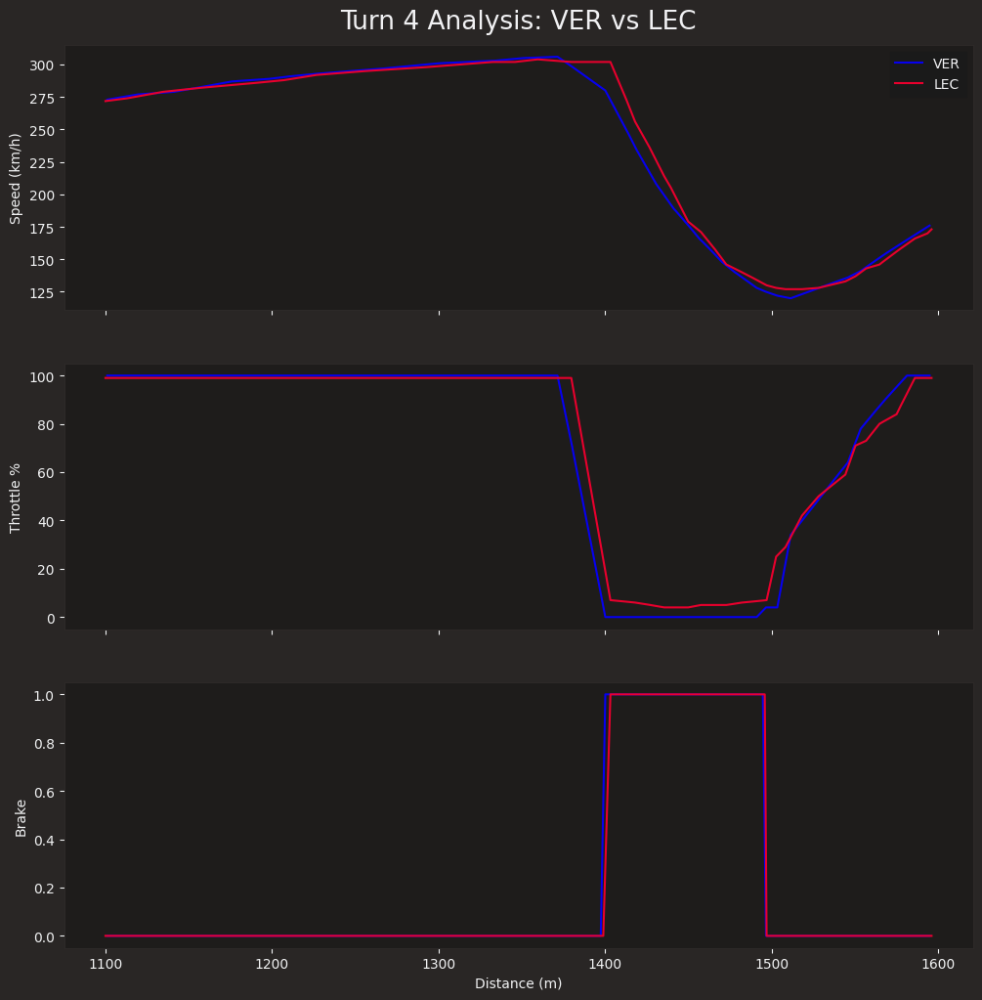

In [18]:


driver1 = 'VER'
driver2 = 'LEC'

# 2. Get Telemetry
laps_d1 = session.laps.pick_drivers(driver1).pick_fastest()
laps_d2 = session.laps.pick_drivers(driver2).pick_fastest()

tel_d1 = laps_d1.get_telemetry().add_distance()
tel_d2 = laps_d2.get_telemetry().add_distance()

# 3. Focus on a Specific Corner (e.g., Turn 4)
# From your table, Turn 4 is at roughly 1200m - 1400m
# You can check exact distances in your circuit_info, but let's zoom in manually
start_dist = 1100
end_dist = 1600

mask_d1 = (tel_d1['Distance'] >= start_dist) & (tel_d1['Distance'] <= end_dist)
mask_d2 = (tel_d2['Distance'] >= start_dist) & (tel_d2['Distance'] <= end_dist)

# 4. Plotting Inputs
fig, ax = plt.subplots(3, 1, figsize=(12, 12), sharex=True)

# Plot 1: Speed
ax[0].plot(tel_d1.loc[mask_d1, 'Distance'], tel_d1.loc[mask_d1, 'Speed'], color=fastf1.plotting.get_driver_color(driver1, session=session), label=driver1)
ax[0].plot(tel_d2.loc[mask_d2, 'Distance'], tel_d2.loc[mask_d2, 'Speed'], color=fastf1.plotting.get_driver_color(driver2, session=session), label=driver2)
ax[0].set_ylabel('Speed (km/h)')
ax[0].set_title(f'Turn 4 Analysis: {driver1} vs {driver2}')
ax[0].legend()

# Plot 2: Throttle (0-100%)
ax[1].plot(tel_d1.loc[mask_d1, 'Distance'], tel_d1.loc[mask_d1, 'Throttle'], color=fastf1.plotting.get_driver_color(driver1, session=session))
ax[1].plot(tel_d2.loc[mask_d2, 'Distance'], tel_d2.loc[mask_d2, 'Throttle'], color=fastf1.plotting.get_driver_color(driver2, session=session))
ax[1].set_ylabel('Throttle %')

# Plot 3: Brake (On/Off)
ax[2].plot(tel_d1.loc[mask_d1, 'Distance'], tel_d1.loc[mask_d1, 'Brake'], color=fastf1.plotting.get_driver_color(driver1, session=session))
ax[2].plot(tel_d2.loc[mask_d2, 'Distance'], tel_d2.loc[mask_d2, 'Brake'], color=fastf1.plotting.get_driver_color(driver2, session=session))
ax[2].set_ylabel('Brake')
ax[2].set_xlabel('Distance (m)')

plt.show()

/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"


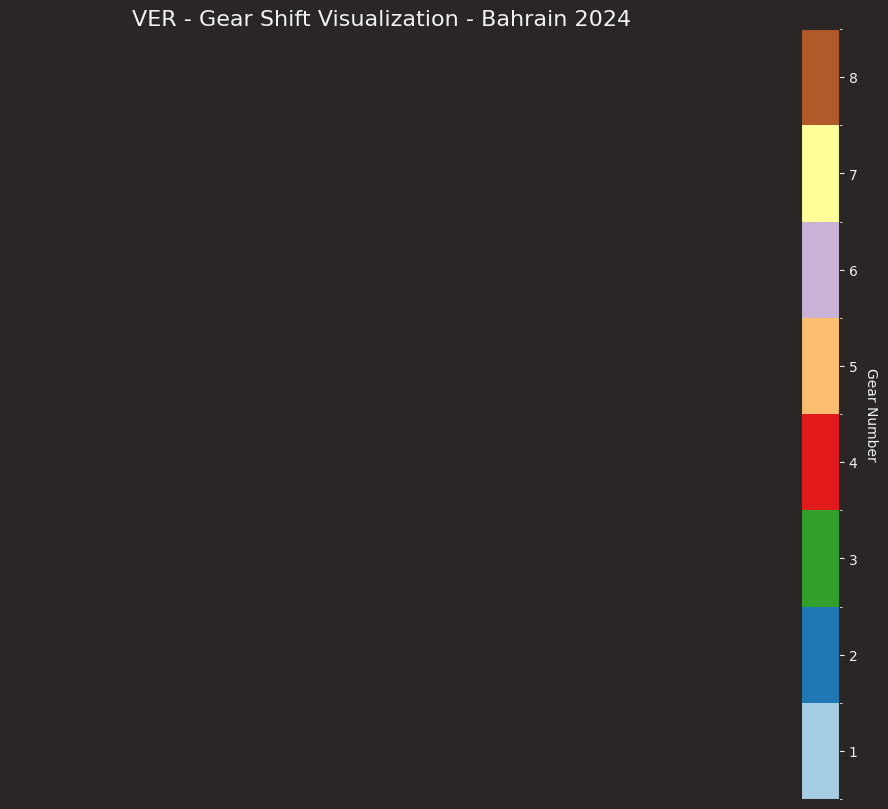

In [19]:

from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap, BoundaryNorm
import numpy as np



# 2. Select Driver and Lap
driver = 'VER'
lap = session.laps.pick_driver(driver).pick_fastest()
tel = lap.get_telemetry().add_distance()

# 3. Data Preparation for "Multicolor" Line
# We need to reshape the data so matplotlib can paint each segment individually
x = np.array(tel['X'].values)
y = np.array(tel['Y'].values)

points = np.array([x, y]).T.reshape(-1, 1, 2)
segments = np.concatenate([points[:-1], points[1:]], axis=1)

# The "feature" we want to color by is the Gear
gear = tel['nGear'].to_numpy().astype(float)

# 4. Create the Colormap
# We have 8 gears, so we want 8 distinct colors.
# 'Paired' is a good matplotlib colormap for categorical data
cmap = plt.get_cmap('Paired', 8)
norm = BoundaryNorm(np.arange(1, 10) - 0.5, ncolors=9)

# 5. Plotting
fig, ax = plt.subplots(sharex=True, sharey=True, figsize=(12, 10))

# Create the LineCollection (this allows different colors per segment)
lc = LineCollection(segments, cmap=cmap, norm=norm, linestyle='-', linewidth=5)
lc.set_array(gear) # Color based on the 'gear' array

# Add the line to the plot
line = ax.add_collection(lc)

# 6. Formatting
ax.axis('off') # Hide grid/axes
ax.set_aspect('equal')
ax.set_title(f"{driver} - Gear Shift Visualization - Bahrain 2024", fontsize=16)

# Add a Colorbar to act as a Legend
cbar = plt.colorbar(line, ax=ax, orientation="vertical", pad=0.05, aspect=20)
cbar.set_label('Gear Number', rotation=270, labelpad=15)
# Fix the ticks to show integers 1-8 nicely
cbar.set_ticks(np.arange(1, 9))
cbar.set_ticklabels(np.arange(1, 9))

plt.show()

--- THE FRANKENSTEIN LAP ---
Sector 1: 28.509s (VER)
Sector 2: 38.059s (LEC)
Sector 3: 22.263s (LEC)
Optimal Lap: 88.831s
Actual Pole: 89.165s
Difference:  0.334s


/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"
/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"
/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"


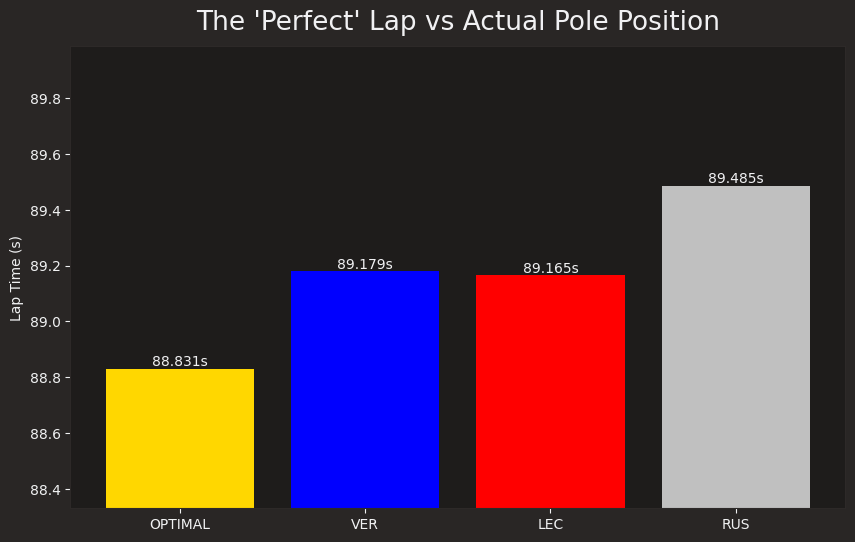

In [20]:


# 2. Get all distinct drivers
drivers = session.drivers
actual_pole = session.laps.pick_fastest().LapTime.total_seconds()

# 3. Calculate Best Sectors across the ENTIRE GRID
# We pick all valid laps (no in-laps/out-laps)
all_laps = session.laps.pick_quicklaps()

best_s1 = all_laps['Sector1Time'].min().total_seconds()
best_s2 = all_laps['Sector2Time'].min().total_seconds()
best_s3 = all_laps['Sector3Time'].min().total_seconds()

optimal_lap = best_s1 + best_s2 + best_s3

# 4. Find out WHO set those best sectors
# We need to find the driver associated with that min time
s1_driver = all_laps.loc[all_laps['Sector1Time'] == all_laps['Sector1Time'].min(), 'Driver'].iloc[0]
s2_driver = all_laps.loc[all_laps['Sector2Time'] == all_laps['Sector2Time'].min(), 'Driver'].iloc[0]
s3_driver = all_laps.loc[all_laps['Sector3Time'] == all_laps['Sector3Time'].min(), 'Driver'].iloc[0]

print(f"--- THE FRANKENSTEIN LAP ---")
print(f"Sector 1: {best_s1:.3f}s ({s1_driver})")
print(f"Sector 2: {best_s2:.3f}s ({s2_driver})")
print(f"Sector 3: {best_s3:.3f}s ({s3_driver})")
print(f"=" * 30)
print(f"Optimal Lap: {optimal_lap:.3f}s")
print(f"Actual Pole: {actual_pole:.3f}s")
print(f"Difference:  {actual_pole - optimal_lap:.3f}s")

# 5. Visualization: Bar Chart Comparison
# Let's compare the Top 3 drivers' actual times vs the Frankenstein time
top_3 = session.laps.pick_fastest().iloc[:3] # This logic might need sorting, let's grab specific drivers
drivers_to_compare = ['VER', 'LEC', 'RUS'] # Adjust based on who was top 3
times = []
names = []

for d in drivers_to_compare:
    lap = session.laps.pick_driver(d).pick_fastest()
    times.append(lap.LapTime.total_seconds())
    names.append(d)

# Add the Optimal Lap
times.insert(0, optimal_lap)
names.insert(0, 'OPTIMAL')

# Plot
fig, ax = plt.subplots(figsize=(10, 6))
bars = ax.bar(names, times, color=['gold', 'blue', 'red', 'silver'])

# Zoom in the Y-axis to see the tiny differences
# We set the bottom limit slightly below the optimal time
min_time = min(times)
ax.set_ylim(min_time - 0.5, max(times) + 0.5)

ax.set_ylabel("Lap Time (s)")
ax.set_title("The 'Perfect' Lap vs Actual Pole Position")

# Add labels on top of bars
for bar in bars:
    height = bar.get_height()
    ax.text(bar.get_x() + bar.get_width()/2., height,
            f'{height:.3f}s',
            ha='center', va='bottom')

plt.show()

In [22]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# 2. Get Data for Two Drivers
d1_name = 'VER'
d2_name = 'LEC'

laps_d1 = session.laps.pick_driver(d1_name).pick_fastest()
laps_d2 = session.laps.pick_driver(d2_name).pick_fastest()

# Get Telemetry
tel_d1 = laps_d1.get_telemetry()
tel_d2 = laps_d2.get_telemetry()

# 3. Synchronize Data (Interpolation)
# We need both cars to have data points at the exact same TIMESTAMPS to animate them together
# We create a common time array based on the slower lap to ensure we catch everything
max_time = max(tel_d1['Time'].max(), tel_d2['Time'].max())
common_time = np.arange(0, max_time.total_seconds(), 0.1) # 0.1s intervals (10fps)

# Create a function to interpolate X, Y coordinates
def interpolate_telemetry(tel, time_array):
    # Convert telemetry time to seconds
    tel_time_sec = tel['Time'].dt.total_seconds()

    # Interpolate X and Y
    interp_x = np.interp(time_array, tel_time_sec, tel['X'])
    interp_y = np.interp(time_array, tel_time_sec, tel['Y'])
    return interp_x, interp_y

d1_x, d1_y = interpolate_telemetry(tel_d1, common_time)
d2_x, d2_y = interpolate_telemetry(tel_d2, common_time)

# 4. Setup the Plot
fig, ax = plt.subplots(figsize=(10, 10))
ax.axis('off')

# Draw the full track first (static background)
ax.plot(d1_x, d1_y, color='grey', linewidth=1, alpha=0.5)

# Initialize the two "dots" (cars)
# zorder=5 ensures dots are on top of the track line
dot_d1, = ax.plot([], [], 'o', color=fastf1.plotting.get_driver_color(d1_name, session=session), markersize=12, label=d1_name, zorder=5)
dot_d2, = ax.plot([], [], 'o', color=fastf1.plotting.get_driver_color(d2_name, session=session), markersize=12, label=d2_name, zorder=5)

# Add a timer text
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes, color='white', fontsize=14)
ax.legend(loc='upper right')

# 5. Animation Function
def update(frame):
    # Update positions
    dot_d1.set_data([d1_x[frame]], [d1_y[frame]])  # Must be sequences (lists)
    dot_d2.set_data([d2_x[frame]], [d2_y[frame]])

    # Update timer
    current_time = common_time[frame]
    time_text.set_text(f"Time: {current_time:.1f}s")

    return dot_d1, dot_d2, time_text

# 6. Generate Animation
print("Generating Animation... (This may take a minute)")
frames = len(common_time)
anim = FuncAnimation(fig, update, frames=frames, interval=100, blit=True)

# 7. Display in Colab
plt.close() # Prevents showing the static plot
HTML(anim.to_jshtml())

/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"
/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"


Generating Animation... (This may take a minute)


/usr/local/lib/python3.12/dist-packages/fastf1/core.py:3081: FutureWarning: pick_driver is deprecated and will be removed in a future release. Use pick_drivers instead.
  warnings.warn(("pick_driver is deprecated and will be removed"


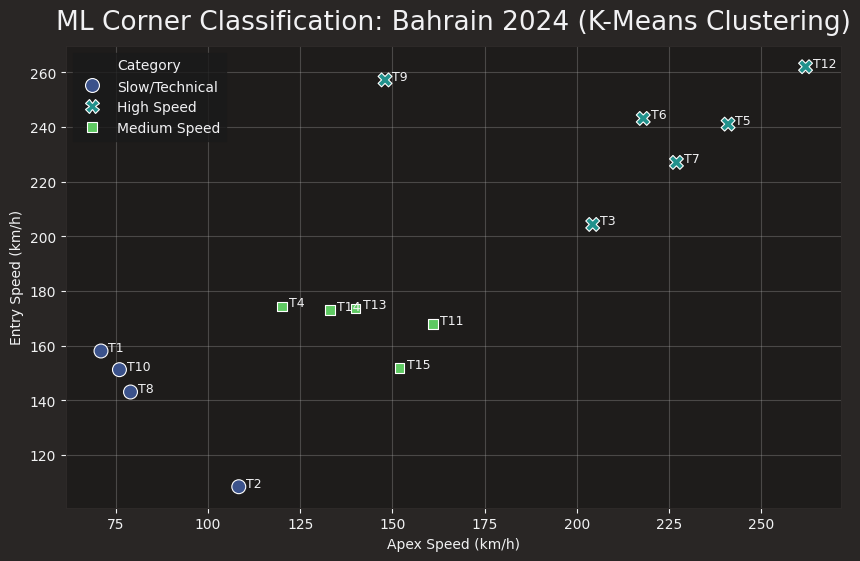

    CornerNumber        Category    MinSpeed
0              1  Slow/Technical   71.000000
9             10  Slow/Technical   76.000000
7              8  Slow/Technical   79.000000
1              2  Slow/Technical  108.350003
3              4    Medium Speed  120.000000
13            14    Medium Speed  133.000000
12            13    Medium Speed  140.000000
8              9      High Speed  148.000000
14            15    Medium Speed  151.912506
10            11    Medium Speed  161.000000
2              3      High Speed  204.300004
5              6      High Speed  218.000000
6              7      High Speed  227.000000
4              5      High Speed  241.000000
11            12      High Speed  262.000000


In [23]:

import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler



# Use Verstappen's lap as the "reference" for corner speeds
lap = session.laps.pick_driver('VER').pick_fastest()
tel = lap.get_telemetry().add_distance()
circuit_info = session.get_circuit_info()

# 2. Feature Extraction (Build the Dataset)
corner_features = []

for index, row in circuit_info.corners.iterrows():
    # Define a window around the corner
    track_buffer = 50
    start_dist = row['Distance'] - track_buffer
    end_dist = row['Distance'] + track_buffer

    # Get telemetry for this corner
    segment = tel[(tel['Distance'] >= start_dist) & (tel['Distance'] <= end_dist)]

    if not segment.empty:
        # FEATURE 1: Minimum Speed (Apex Speed)
        min_speed = segment['Speed'].min()

        # FEATURE 2: Entry Speed (Speed at the start of the buffer)
        entry_speed = segment['Speed'].iloc[0]

        corner_features.append({
            'CornerNumber': row['Number'],
            'MinSpeed': min_speed,
            'EntrySpeed': entry_speed
        })

df_ml = pd.DataFrame(corner_features)

# 3. Machine Learning (K-Means)
# We want to cluster based on Speed data
X = df_ml[['MinSpeed', 'EntrySpeed']]

# Normalize the data (important for K-Means)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply K-Means with 3 Clusters (Slow, Medium, Fast)
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
df_ml['Cluster'] = kmeans.fit_predict(X_scaled)

# Map Cluster IDs to human names
# (We check the average speed of each cluster to know which is which)
cluster_means = df_ml.groupby('Cluster')['MinSpeed'].mean().sort_values()
cluster_map = {
    cluster_means.index[0]: 'Slow/Technical',
    cluster_means.index[1]: 'Medium Speed',
    cluster_means.index[2]: 'High Speed'
}
df_ml['Category'] = df_ml['Cluster'].map(cluster_map)

# 4. Visualization
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_ml, x='MinSpeed', y='EntrySpeed', hue='Category',
                palette='viridis', s=100, style='Category')

# Label points with Corner Numbers
for i in range(df_ml.shape[0]):
    plt.text(df_ml.MinSpeed[i]+2, df_ml.EntrySpeed[i],
             f"T{df_ml.CornerNumber[i]}", fontsize=9)

plt.title('ML Corner Classification: Bahrain 2024 (K-Means Clustering)')
plt.xlabel('Apex Speed (km/h)')
plt.ylabel('Entry Speed (km/h)')
plt.grid(True, alpha=0.3)
plt.show()

# Print the grouping
print(df_ml[['CornerNumber', 'Category', 'MinSpeed']].sort_values('MinSpeed'))

core           INFO 	Loading data for Bahrain Grand Prix - Race [v3.7.0]
INFO:fastf1.fastf1.core:Loading data for Bahrain Grand Prix - Race [v3.7.0]
req            INFO 	No cached data found for session_info. Loading data...
INFO:fastf1.fastf1.req:No cached data found for session_info. Loading data...
_api           INFO 	Fetching session info data...
INFO:fastf1.api:Fetching session info data...
req            INFO 	Data has been written to cache!
INFO:fastf1.fastf1.req:Data has been written to cache!
req            INFO 	No cached data found for driver_info. Loading data...
INFO:fastf1.fastf1.req:No cached data found for driver_info. Loading data...
_api           INFO 	Fetching driver list...
INFO:fastf1.api:Fetching driver list...
req            INFO 	Data has been written to cache!
INFO:fastf1.fastf1.req:Data has been written to cache!
req            INFO 	No cached data found for session_status_data. Loading data...
INFO:fastf1.fastf1.req:No cached data found for session_status_d

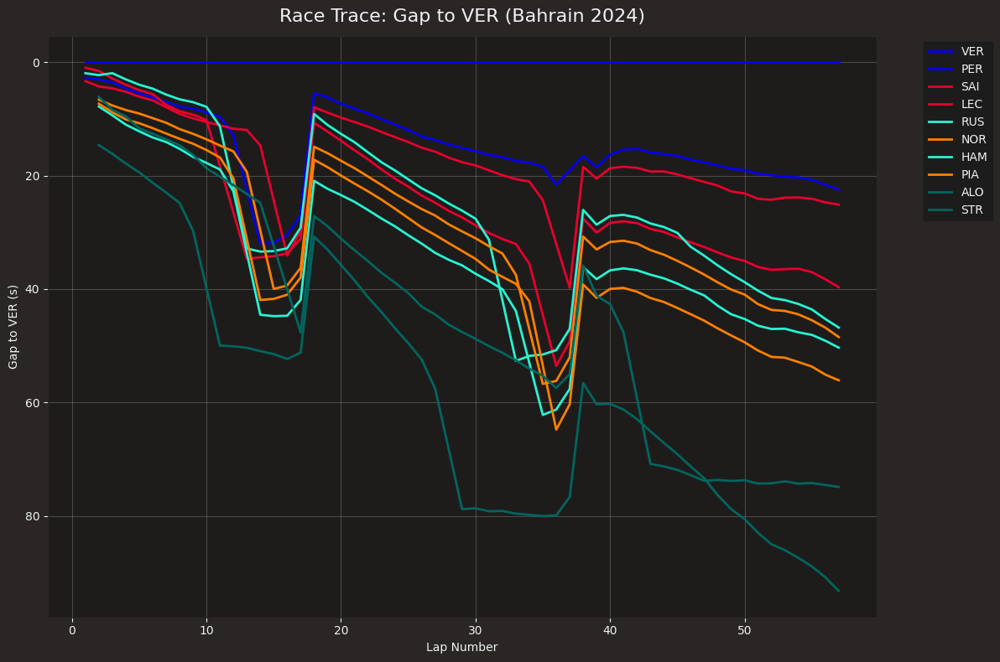

In [28]:

session = fastf1.get_session(2024, 'Bahrain', 'R')
session.load()

# 2. Get the Winner (for reference gap)
# We use position 1 from the results to be safe
winner_name = session.results.loc[session.results['Position'] == 1, 'Abbreviation'].iloc[0]
winner_laps = session.laps.pick_driver(winner_name)

# Create a clean "Master Time" table for the winner to compare against
# We just need LapNumber and their cumulative time
winner_laps = winner_laps[['LapNumber', 'Time']].copy()
winner_laps.rename(columns={'Time': 'WinnerTime'}, inplace=True)

# 3. Process Top 10 Drivers
# Get the abbreviations of the top 10 finishers
top_10_drivers = session.results.iloc[:10]['Abbreviation'].tolist()

fig, ax = plt.subplots(figsize=(12, 8))

for driver in top_10_drivers:
    # Use the Abbreviation (e.g., 'VER') which avoids the "KeyError: 1"
    driver_laps = session.laps.pick_driver(driver).pick_quicklaps().reset_index()

    # Merge with winner's time on LapNumber to calculate the gap
    merged = pd.merge(driver_laps, winner_laps, on='LapNumber', how='inner')

    # Calculate Gap: (Driver Time - Winner Time)
    # Convert to seconds
    merged['GapToLeader'] = (merged['Time'] - merged['WinnerTime']).dt.total_seconds()

    # Plotting
    driver_color = fastf1.plotting.get_driver_color(driver, session=session)
    sns.lineplot(x=merged['LapNumber'], y=merged['GapToLeader'],
                 label=driver, color=driver_color, linewidth=2, ax=ax)

# 4. Formatting
ax.invert_yaxis() # Leader (0 gap) is at the top
ax.set_title(f"Race Trace: Gap to {winner_name} (Bahrain 2024)", fontsize=16)
ax.set_xlabel("Lap Number")
ax.set_ylabel(f"Gap to {winner_name} (s)")
ax.grid(True, alpha=0.3)
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left') # Move legend outside

plt.tight_layout()
plt.show()

core           INFO 	Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
INFO:fastf1.fastf1.core:Loading data for Bahrain Grand Prix - Qualifying [v3.7.0]
req            INFO 	Using cached data for session_info
INFO:fastf1.fastf1.req:Using cached data for session_info
req            INFO 	Using cached data for driver_info
INFO:fastf1.fastf1.req:Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
INFO:fastf1.fastf1.req:Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
INFO:fastf1.fastf1.req:Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
INFO:fastf1.fastf1.req:Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
INFO:fastf1.fastf1.req:Using cached data for timing_app_data
core           INFO 	Processing timing data...
INFO:fastf1.fastf1.core:Processing timing data...
req         

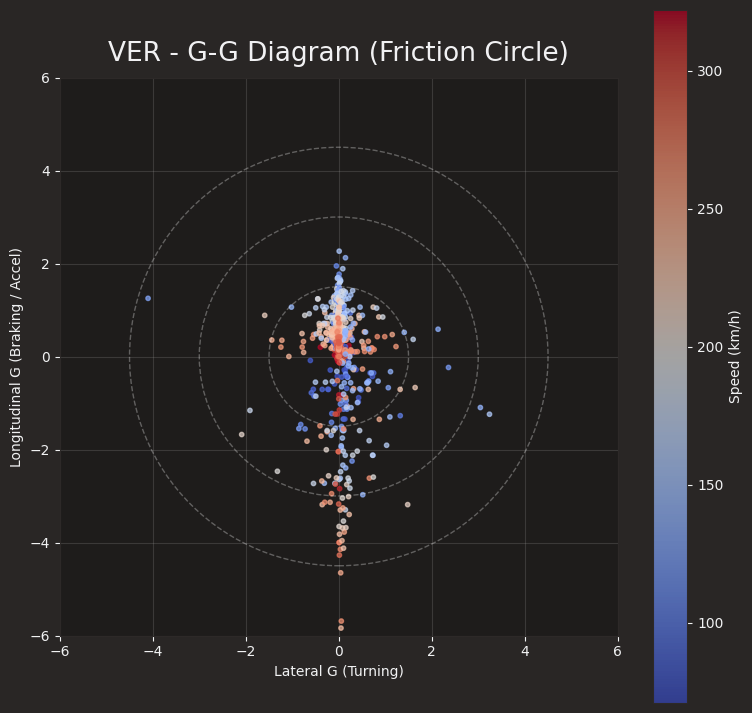

In [27]:


session = fastf1.get_session(2024, 'Bahrain', 'Q')
session.load()

# 2. Select Driver
driver = 'VER'
lap = session.laps.pick_driver(driver).pick_fastest()
tel = lap.get_telemetry()

# 3. Physics Calculations
# Convert km/h to m/s
tel['SpeedMS'] = tel['Speed'] / 3.6

# Longitudinal Accel (Braking/Gas) = Change in Speed / Change in Time
# Gradient calculates the difference between points
tel['dSpeed'] = np.gradient(tel['SpeedMS'])
tel['dTime'] = np.gradient(tel['Time'].dt.total_seconds())
tel['LongAccel'] = tel['dSpeed'] / tel['dTime'] / 9.81 # Convert to G-Force

# Lateral Accel (Turning) = (Speed^2) / Radius OR Speed * AngularVelocity
# We can estimate Angular Velocity from 'Course' (Heading) changes if available,
# but usually we use a simpler Speed * dHeading approximation or XY coordinate curvature.
# Let's use coordinate curvature (X, Y)
x = tel['X'].values
y = tel['Y'].values

# Calculate curvature (k) using first and second derivatives of position
dx = np.gradient(x)
dy = np.gradient(y)
ddx = np.gradient(dx)
ddy = np.gradient(dy)

# Curvature formula: (dx*ddy - dy*ddx) / (dx^2 + dy^2)^(3/2)
curvature = (dx * ddy - dy * ddx) / np.power(dx**2 + dy**2, 1.5)

# LatAccel = Speed^2 * Curvature / 9.81
# Note: This is an estimation and can be noisy!
tel['LatAccel'] = (tel['SpeedMS']**2 * curvature) / 9.81
# Flip sign for intuitive Left/Right
tel['LatAccel'] = -tel['LatAccel']

# 4. Plotting
fig, ax = plt.subplots(figsize=(9, 9))

# Scatter plot of the G-Forces
# Color by Speed to see where the high-speed loads are
sc = ax.scatter(tel['LatAccel'], tel['LongAccel'],
                c=tel['Speed'], cmap='coolwarm', s=10, alpha=0.7)

# Add circles to show 1G, 2G, 3G limits
circle1 = plt.Circle((0, 0), 1.5, color='white', fill=False, linestyle='--', alpha=0.3)
circle2 = plt.Circle((0, 0), 3.0, color='white', fill=False, linestyle='--', alpha=0.3)
circle3 = plt.Circle((0, 0), 4.5, color='white', fill=False, linestyle='--', alpha=0.3)

ax.add_artist(circle1)
ax.add_artist(circle2)
ax.add_artist(circle3)

ax.set_xlabel("Lateral G (Turning)")
ax.set_ylabel("Longitudinal G (Braking / Accel)")
ax.set_title(f"{driver} - G-G Diagram (Friction Circle)")
ax.grid(True, alpha=0.2)
ax.set_aspect('equal')

# Limit axis to clean up noise (F1 cars rarely pull > 6G)
ax.set_xlim(-6, 6)
ax.set_ylim(-6, 6)

plt.colorbar(sc, label="Speed (km/h)")
plt.show()